In [ ]:
from keras.layers import BatchNormalization, Reshape, Dense, Input, LeakyReLU, Conv2D, Conv2DTranspose, Concatenate, ReLU, Dropout, ZeroPadding2D
!pip install git+https://www.github.com/keras-team/keras-contrib.git
from keras_contrib.layers.normalization.instancenormalization import InstanceNormalization
from keras.models import Model
from keras.initializers import RandomNormal
from keras.optimizers import Adam

import numpy as np
from numpy.random import randint
from tqdm import tqdm
import matplotlib.pyplot as plt

from random import random
import pickle
import time
import cv2
import os

  Cloning https://www.github.com/keras-team/keras-contrib.git to /tmp/pip-req-build-1ic2l3jl
  Running command git clone -q https://www.github.com/keras-team/keras-contrib.git /tmp/pip-req-build-1ic2l3jl
  Created wheel for keras-contrib: filename=keras_contrib-2.0.8-py3-none-any.whl size=101064 sha256=6b62c6a93594be021c90c66a2875ff8f5fbc3bc1ca02db16d691aff4cffc199c
  Stored in directory: /tmp/pip-ephem-wheel-cache-lk2zbhvt/wheels/bb/1f/f2/b57495012683b6b20bbae94a3915ec79753111452d79886abc
Successfully built keras-contrib


## Loading Data
the load data function is a function that read the images in the given path and yield them one by one. we used the yield so there is no need to load all data in the RAM and we can use the single imge that we want.

In [ ]:
def load_data(path):
    
    for files in os.listdir(path):
        file_path = os.path.join(path, files)
        img = cv2.imread(file_path)
        yield np.array([img]) / 127.5 - 1

In [ ]:
a_train = load_data('../input/monet2photo/trainA')
b_train = load_data('../input/monet2photo/trainB')
a_test = load_data('../input/monet2photo/testA')
b_test = load_data('../input/monet2photo/testB')

here we load the tests data and the A set (which contains the Monet paintings) in the RAM. but the B set which is the largest (that contains real photoes) s not load

In [ ]:
a_test = np.array(list(a_test))
b_test = np.array(list(b_test))
a_train = list(a_train)

## Generator
Here we implemented a U-Net architecture which is an encoder-decoder with severl convolutional block in the encoder part and several deconvolutional layers in the decoder layer. the Used normalization here is the InstanceNormalization and the activation function in the Leaky-Relu. 
the role of this part is to take an input as an image and output another image with the features that we will explain in future parts.

we used the Normal distribuation with stddev of 0.02 for weight initialization of the network.

In [ ]:
def generator(init):
        
    image_input = Input(shape=(256, 256, 3))

    conv_1 = Conv2D(64, 4, strides=2, kernel_initializer=init, padding='same', use_bias=False)(image_input)
    act_1 = LeakyReLU(alpha=0.2)(conv_1)
    conv_2 = Conv2D(128, 4, strides=2, kernel_initializer=init, padding='same', use_bias=False)(act_1)
    norm_2 = InstanceNormalization()(conv_2)
    act_2 = LeakyReLU(alpha=0.2)(norm_2)
    conv_3 = Conv2D(256, 4, strides=2, kernel_initializer=init, padding='same', use_bias=False)(act_2)
    norm_3 = InstanceNormalization()(conv_3)
    act_3 = LeakyReLU(alpha=0.2)(norm_3)
    conv_4 = Conv2D(512, 4, strides=2, kernel_initializer=init, padding='same', use_bias=False)(act_3)
    norm_4 = InstanceNormalization()(conv_4)
    act_4 = LeakyReLU(alpha=0.2)(norm_4)
    conv_5 = Conv2D(512, 4, strides=2, kernel_initializer=init, padding='same', use_bias=False)(act_4)
    norm_5 = InstanceNormalization()(conv_5)
    act_5 = LeakyReLU(alpha=0.2)(norm_5)
    conv_6 = Conv2D(512, 4, strides=2, kernel_initializer=init, padding='same', use_bias=False)(act_5)
    norm_6 = InstanceNormalization()(conv_6)
    act_6 = LeakyReLU(alpha=0.2)(norm_6)
    conv_7 = Conv2D(512, 4, strides=2, kernel_initializer=init, padding='same', use_bias=False)(act_6)
    norm_7 = InstanceNormalization()(conv_7)
    act_7= LeakyReLU(alpha=0.2)(norm_7)
    conv_8 = Conv2D(512, 4, strides=2, kernel_initializer=init, padding='same', use_bias=False)(act_7)
    norm_8 = InstanceNormalization()(conv_8)
    act_8 = LeakyReLU(alpha=0.2)(norm_8)

    convt_1 = Conv2DTranspose(512, 4, strides=2, kernel_initializer=init, padding='same', use_bias=False)(act_8)
    normt_1 = InstanceNormalization()(convt_1)
    drop_1 = Dropout(0.5)(normt_1)
    actt_1 = ReLU()(drop_1)
    concat_1 = Concatenate()([actt_1, act_7])
    convt_2 = Conv2DTranspose(512, 4, strides=2, kernel_initializer=init, padding='same', use_bias=False)(concat_1)
    normt_2 = InstanceNormalization()(convt_2)
    drop_2 = Dropout(0.5)(normt_2)
    actt_2 = ReLU()(drop_2)
    concat_2 = Concatenate()([actt_2, act_6])
    convt_3 = Conv2DTranspose(512, 4, strides=2, kernel_initializer=init, padding='same', use_bias=False)(concat_2)
    normt_3 = InstanceNormalization()(convt_3)
    drop_3 = Dropout(0.5)(normt_3)
    actt_3 = ReLU()(drop_3)
    concat_3 = Concatenate()([actt_3, act_5])
    convt_4 = Conv2DTranspose(512, 4, strides=2, kernel_initializer=init, padding='same', use_bias=False)(concat_3)
    normt_4 = InstanceNormalization()(convt_4)
    actt_4 = ReLU()(normt_4)
    concat_4 = Concatenate()([actt_4, act_4])
    convt_5 = Conv2DTranspose(256, 4, strides=2, kernel_initializer=init, padding='same', use_bias=False)(concat_4)
    normt_5 = InstanceNormalization()(convt_5)
    actt_5 = ReLU()(normt_5)
    concat_5 = Concatenate()([actt_5, act_3])
    convt_6 = Conv2DTranspose(128, 4, strides=2, kernel_initializer=init, padding='same', use_bias=False)(concat_5)
    normt_6 = InstanceNormalization()(convt_6)
    actt_6 = ReLU()(normt_6)
    concat_6 = Concatenate()([actt_6, act_2])
    convt_7 = Conv2DTranspose(64, 4, strides=2, kernel_initializer=init, padding='same', use_bias=False)(concat_6)
    normt_7 = InstanceNormalization()(convt_7)
    actt_7 = ReLU()(normt_7)
    concat_7 = Concatenate()([actt_7, act_1])
    
    outputs = Conv2DTranspose(3, 4, strides=2, activation='tanh', kernel_initializer=init, padding='same')(concat_7)
    
    gen_model = Model(image_input, outputs)

    return gen_model

## Discriminator
for implementing the discriminator, we used a patchGAN discriminator that learns to detect the real/fake label for different patches in the image and determine the actual output based on these patches. 
it has several convolutional blocks for extracting features and one for making the patches. 
the role of this part is to distinguish between a fake data and a real one. 
we explain the use of this discriminator in more details in next parts.

we used the Normal distribuation with stddev of 0.02 for weight initialization of the network.

In [ ]:
def discriminator(init):
        
    img_inp = Input(shape = (256, 256, 3))

    conv_1 = Conv2D(64, 4, strides=2, kernel_initializer=init, padding='same', use_bias=False)(img_inp)
    act_1 = LeakyReLU(alpha=0.2)(conv_1)
    
    conv_2 = Conv2D(128, 4, strides=2, kernel_initializer=init, padding='same', use_bias=False)(act_1)
    norm_2 = InstanceNormalization()(conv_2)
    act_2 = LeakyReLU(alpha=0.2)(norm_2)
    
    conv_3 = Conv2D(256, 4, strides=2, kernel_initializer=init, padding='same', use_bias=False)(act_2)
    norm_3 = InstanceNormalization()(conv_3)
    act_3 = LeakyReLU(alpha=0.2)(norm_3)
    
    zero_pad1 = ZeroPadding2D()(act_3)
    
    conv_4 = Conv2D(512, 4, strides=1, kernel_initializer=init, padding='same', use_bias=False)(zero_pad1)
    norm_4 = InstanceNormalization()(conv_4)
    act_4 = LeakyReLU(alpha=0.2)(norm_4)
    
    zero_pad2 = ZeroPadding2D()(act_4)
    
    patch_out = Conv2D(1, 4, strides=1, padding='same', kernel_initializer=init)(zero_pad2)
    
    disc_model = Model(img_inp, patch_out)
    disc_model.compile(loss='mse', optimizer=Adam(lr=0.0002, beta_1=0.5), loss_weights=[0.5])

    return disc_model

## Combined Model
for training the generators, we need to make some loops. here we have 4 different type of outputs.
we will explain this procedure for a generator which wants to map the inputs X to outputs Y. (we have another generator for mapping Y to X) 

1- we feed an input x to the x->y generator, and then give its out put to Y-Discriminator to determine the class of this (real and fake) this output is one of the 4.

2- we feed an input y to the x->y generator, and we want that the output of this generator be the same as the input. (identity)

3- we feed an input x to the x->y generator, then feed its output to the y->x generator to reconstruct the input x. (forward cycle consistency)

4- we feed and inpyt y to the y->x generator, then feed its output to the x->y generator to reconstruct the input y. (backward cycle consistency)

all these is because help the generators to chage the domain of inputs in an appropriate way that the input and outpts are actually the mapping of each other. not a random sample form the other space. 

## losses
we have three losses to use here. 

The adveserial:

 is related to the 1. when we want the discriminator distinguish between real and fake data. 
 
 The identity loss:
 
 is related to 2. where we want the input and the output be the same.
 
The Cycle consistency loss:

 is related to 3 and 4. the sum of losses of these two parts that we want to be able to reconstruct the input after passing the 2 generators in a sequential manner.

In [ ]:
def define_composite_model(g_model1, d_model, g_model2):

    g_model1.trainable = True
    d_model.trainable = False
    g_model2.trainable = False
    
    image_shape = (256, 256, 3)

    inp = Input(shape=image_shape)
    gen1_out = g_model1(inp)
    output_d = d_model(gen1_out)
    
    inp_id = Input(shape=image_shape)
    output_id = g_model1(inp_id)
    
    output_f = g_model2(gen1_out)
    
    gen2_out = g_model2(inp_id)
    output_b = g_model1(gen2_out)
    
    model = Model([inp, inp_id], [output_d, output_id, output_f, output_b])
    
    opt = Adam(lr=0.0002, beta_1=0.5)
    model.compile(loss=['mse', 'mae', 'mae', 'mae'], loss_weights=[1, 5, 10, 10], optimizer=opt)
    
    return model

## Pooling
the paper used a pool which will update on a probability of 0.5 for training the generators (cause our data is unlabled and we want to have a pool of samples of each input space)
there is a function which makes a pool of size 50 and with probability of 0.5 updates one of each samples. 

In [ ]:
def pooling(pool, data, max_size=50):
    
    result = list()
    for sample in data:
        if len(pool) < max_size:
            pool.append(sample)
            result.append(sample)
        elif random() < 0.5:
            result.append(sample)
        else:
            idx = randint(0, len(pool))
            result.append(pool[idx])
            pool[idx] = sample
            
    return np.asarray(result)

## Test
the test function plots some samples and the output of the corresponding generator of these samples. we also use the other generator for reconstructing the input. we have these plots for a single sample or a batch of them.

In [ ]:
def test(generator1, generator2, samples, epoch_end=False):
    
    predicted = generator1.predict(samples[0])
    reconstructed = generator2.predict(predicted)

    figure, axs = plt.subplots(1, 3, figsize=(15,5))
    axs[0].imshow(samples[0].reshape(256, 256, 3))
    axs[0].set_title(f'original')
    axs[0].set_xticks([])
    axs[0].set_yticks([])
    axs[1].imshow(predicted.reshape(256, 256, 3))
    axs[1].set_title(f'generated')
    axs[1].set_xticks([])
    axs[1].set_yticks([])
    axs[2].imshow(reconstructed.reshape(256, 256, 3))
    axs[2].set_title(f'reconstructed')
    axs[2].set_xticks([])
    axs[2].set_yticks([])
    
    plt.show()
    
    if epoch_end:
        
        predicted = generator1.predict(samples.reshape(-1, 256, 256, 3))
        reconstructed = generator2.predict(predicted)
        
        figure, axs = plt.subplots(5, 5, figsize=(15, 15))
        for i in range(5):
            for j in range(5):
                axs[i, j].imshow(samples[i*5+j].reshape(256, 256, 3))
                axs[i, j].set_xticks([])
                axs[i, j].set_yticks([])
#         figure.tight_layout()
        figure.suptitle('Original')
        plt.show()
                
        figure, axs = plt.subplots(5, 5, figsize=(15, 15))
        for i in range(5):
            for j in range(5):
                axs[i, j].imshow(predicted[i*5+j].reshape(256, 256, 3))
                axs[i, j].set_xticks([])
                axs[i, j].set_yticks([])
#         figure.tight_layout()
        figure.suptitle('Generated')
        plt.show()
                
        figure, axs = plt.subplots(5, 5, figsize=(15, 15))
        for i in range(5):
            for j in range(5):
                axs[i, j].imshow(reconstructed[i*5+j].reshape(256, 256, 3))
                axs[i, j].set_xticks([])
                axs[i, j].set_yticks([])
#         figure.tight_layout()
        figure.suptitle('Reconstructed')
        plt.show()

## Train
in each epoch of the train function, we loop on the photoes and we sample a painting from the paintig set. in these loops we train 4 different models, 2 of them are the discriminators A and B (which are once trained by real data and once with the fake data) and 2 generators which are trained using the compiled model that we explain above (the one which had 4 different outputs) and also we plot the test results in proper situations.

In [ ]:
def train(a_disc, b_disc, ab_gen, ba_gen, ab_total, ba_total, a_train, a_test, b_test):
    
    epochs, n_batch, = 2, 1
    
    n_patch = a_disc.output_shape[1]

    pool_a, pool_b = [], []
    ba_loss, a_disc_r, a_disc_f = [], [], []
    ab_loss, b_disc_r, b_disc_f = [], [], []
    for i in range(epochs):
        
        b_train = load_data('../input/monet2photo/trainB')
        t = time.time()
        
        for j, x_b in enumerate(b_train):
            
            y_b = np.ones((1, n_patch, n_patch, 1))
            
            x_a = a_train[randint(0, len(a_train))]
            y_a = np.ones((1, n_patch, n_patch, 1))
            
            x_gen_a = ba_gen.predict(x_b)
            y_gen_a = np.zeros((1, n_patch, n_patch, 1))
            
            x_gen_b = ab_gen.predict(x_a)
            y_gen_b = np.zeros((1, n_patch, n_patch, 1))
            
            x_gen_a = pooling(pool_a, x_gen_a)
            x_gen_b = pooling(pool_b, x_gen_b)
            
            ba_gen_loss, _, _, _, _ = ba_total.train_on_batch([x_b, x_a], [y_a, x_a, x_b, x_a])
            a_disc_loss_real = a_disc.train_on_batch(x_a, y_a)
            a_disc_loss_fake = a_disc.train_on_batch(x_gen_a, y_gen_a)
            ba_loss.append(ba_gen_loss)
            a_disc_r.append(a_disc_loss_real)
            a_disc_f.append(a_disc_loss_fake)
            
            ab_gen_loss, _, _, _, _ = ab_total.train_on_batch([x_a, x_b], [y_b, x_b, x_a, x_b])
            b_disc_loss_real = b_disc.train_on_batch(x_b, y_b)
            b_disc_loss_fake = b_disc.train_on_batch(x_gen_b, y_gen_b)
            ab_loss.append(ab_gen_loss)
            b_disc_r.append(b_disc_loss_real)
            b_disc_f.append(b_disc_loss_fake)
            
            if (j+1) % 1000 == 0:
                
                print(f'processed samples: {j+1} in {time.time() - t}')
                t = time.time()
          
                test(ab_gen, ba_gen, a_test)
                test(ba_gen, ab_gen, b_test)
                
        print(f'epoch {i}:')
        test(ab_gen, ba_gen, a_test, epoch_end=True)
        test(ba_gen, ab_gen, b_test, epoch_end=True)
        
    return ba_loss, a_disc_r, a_disc_f, ab_loss, b_disc_r, b_disc_f
        

## selecting test sample (paintings)
here we select test sample (25) from our test set of paintings to plot them after each epoch. we also plotted the first one.

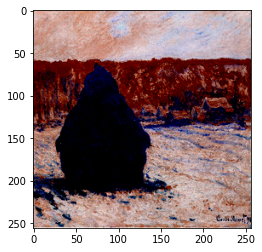

In [ ]:
a_test_idx = randint(0, len(a_test), size=25)
plt.imshow(a_test[a_test_idx[0]].reshape(256, 256, 3))
plt.show()

## selecting test sample (photoes)
here we select test sample (25) from our test set of photoes to plot them after each epoch. we also plotted the first one.

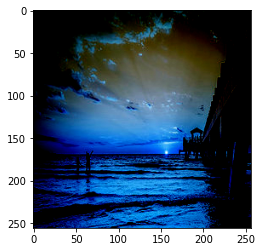

In [ ]:
b_test_idx = randint(0, len(b_test), size=25)
plt.imshow(b_test[b_test_idx[0]].reshape(256, 256, 3))
plt.show()

## Initializing Models
we have to initial 6 different models here, 2 discriminators, 2 generators and 2 combined models from the previous ones (which we explained the the details above) for training the generators using them. 

In [ ]:
init = RandomNormal(stddev=0.02)

ab_gen = generator(init)
ba_gen = generator(init)

a_disc = discriminator(init)
b_disc = discriminator(init)

ab_total = define_composite_model(ab_gen, b_disc, ba_gen)
ba_total = define_composite_model(ba_gen, a_disc, ab_gen)

## Plot Before Training
these are the first test sample of paintings, the generated one using the generator whoes work is to convert it to a real photo, and the reconstructed one using the other generator, all before the training.

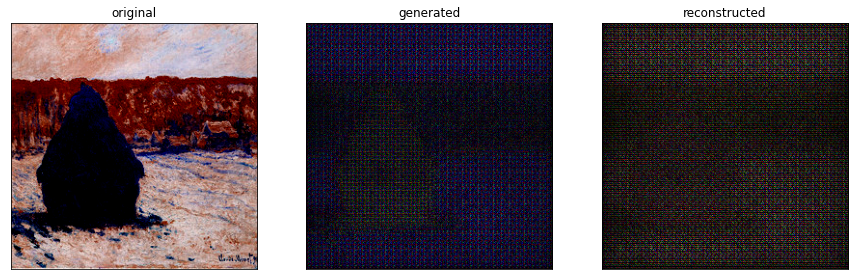

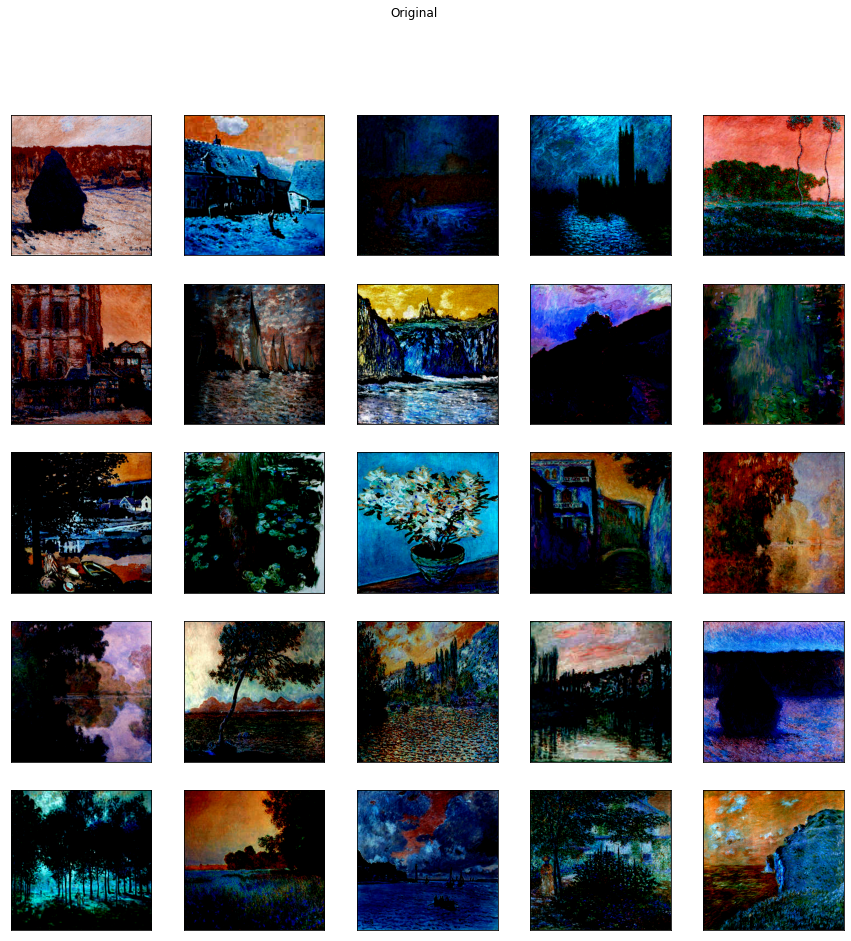

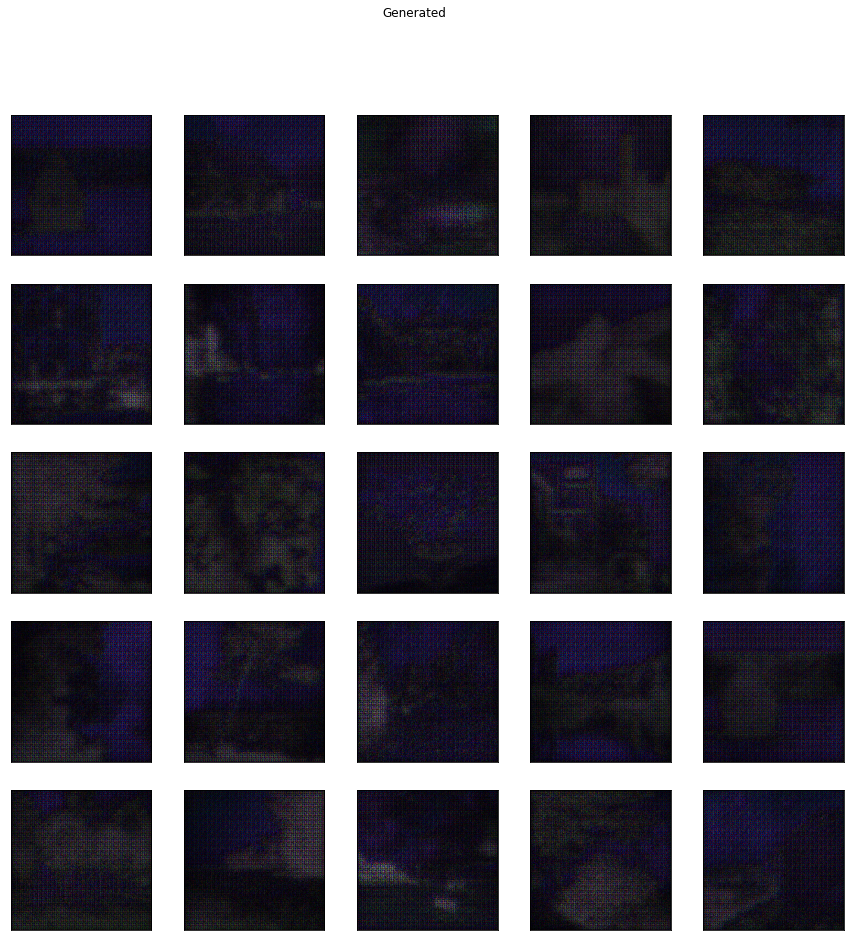

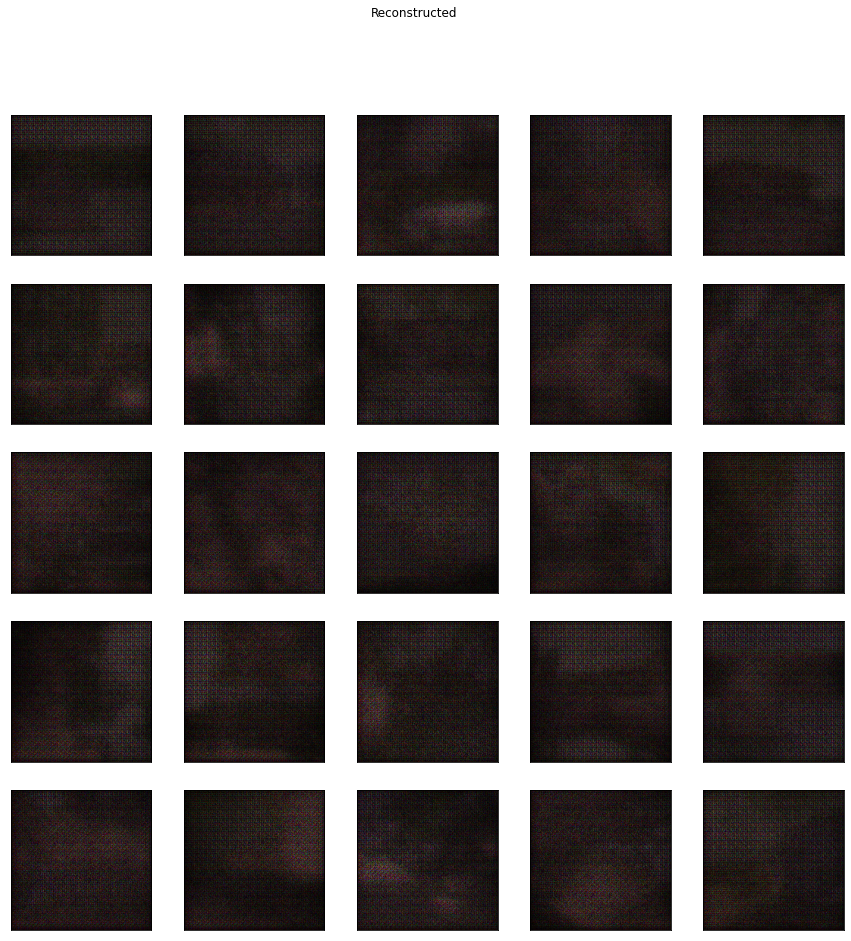

In [ ]:
test(ab_gen, ba_gen, a_test[a_test_idx], epoch_end=True)

## Plot Before Training
these are the first test sample of photoes, the generated one using the generator whoes work is to convert it to a painting, and the reconstructed one using the other generator, all before the training.

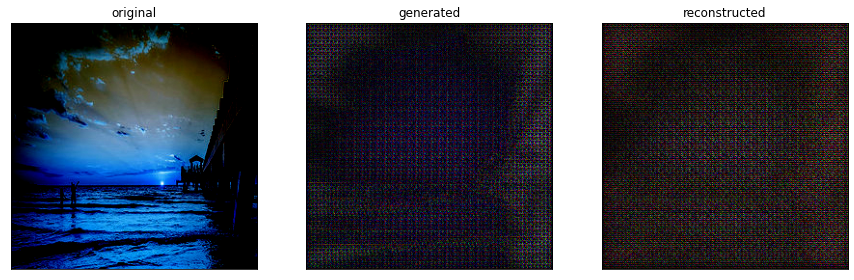

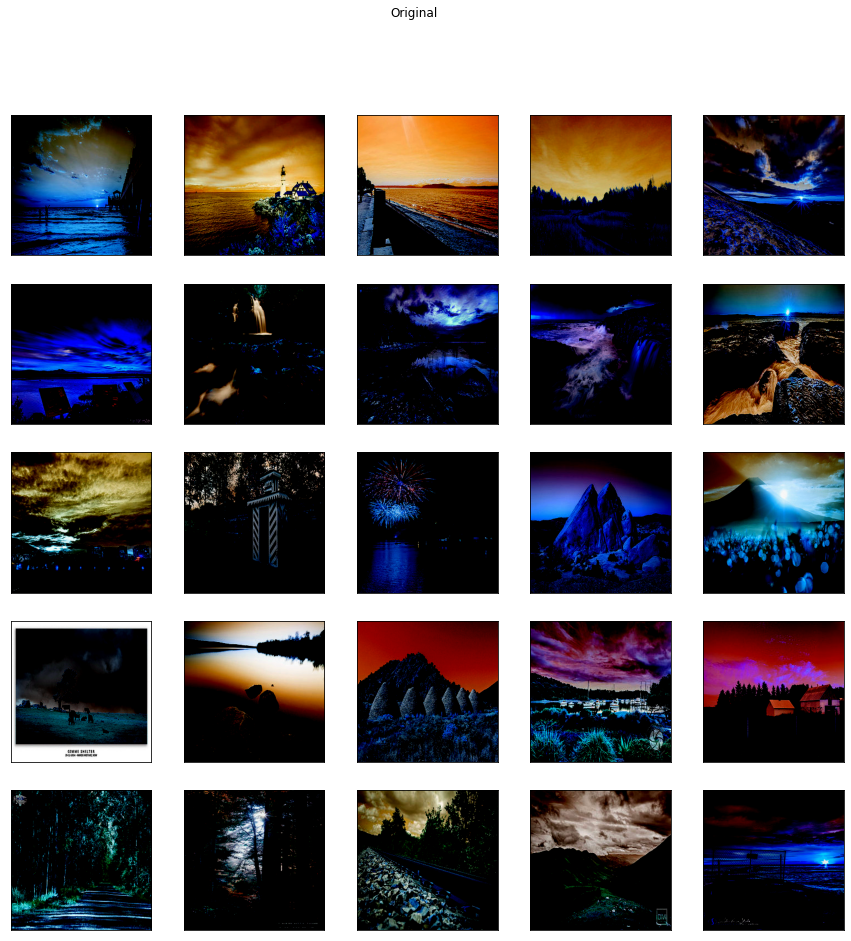

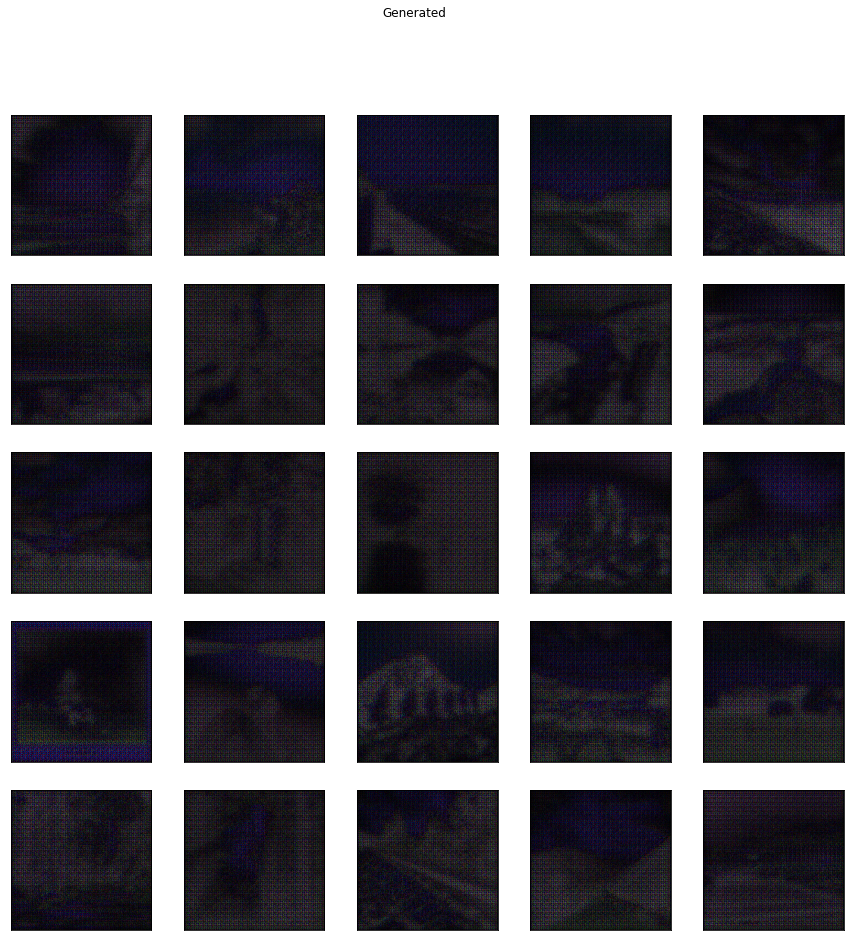

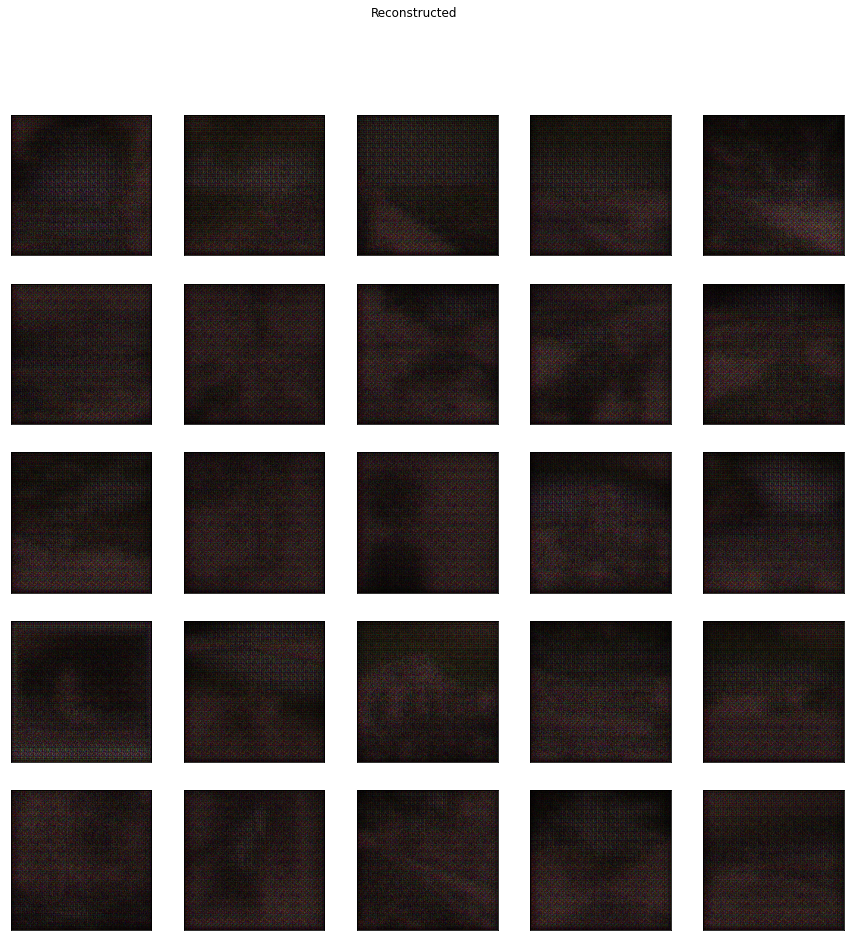

In [ ]:
test(ab_gen, ba_gen, b_test[b_test_idx], epoch_end=True)

## Training
calling the train function with the initialized models. 

processed samples: 1000 in 535.8437201976776


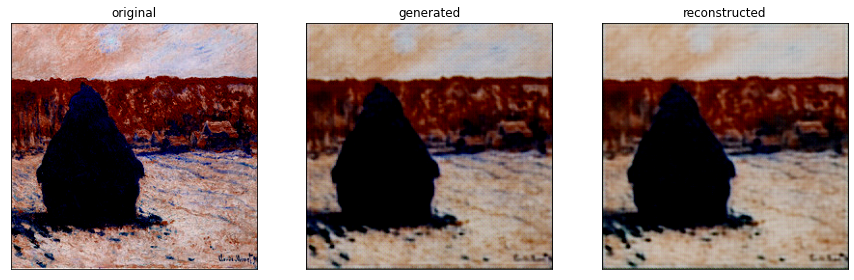

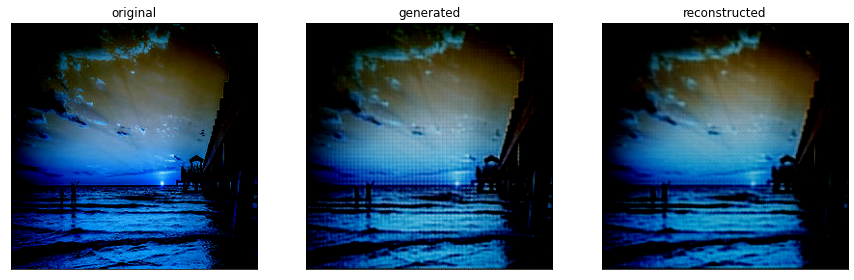

processed samples: 2000 in 508.01313638687134


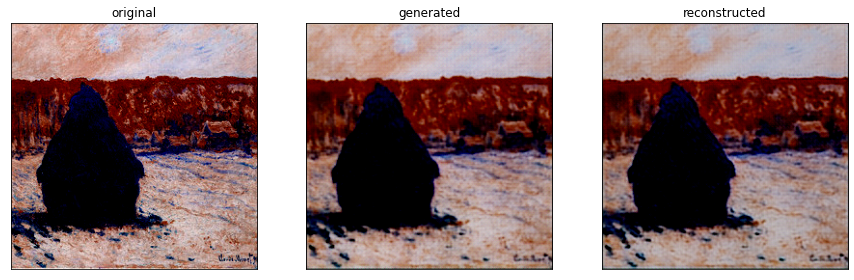

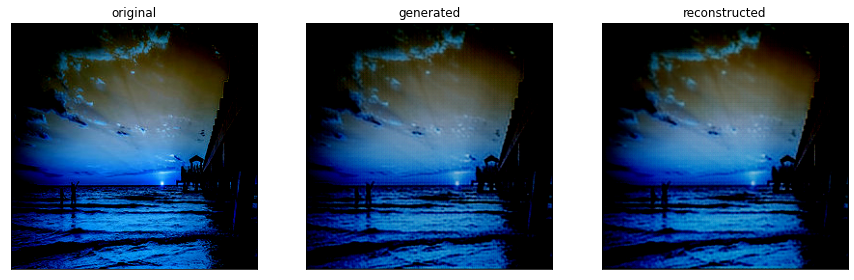

processed samples: 3000 in 521.3582825660706


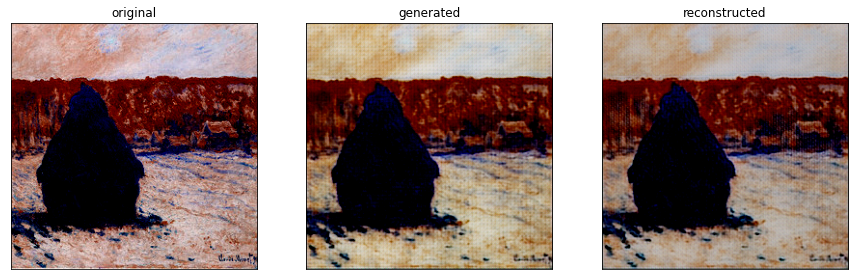

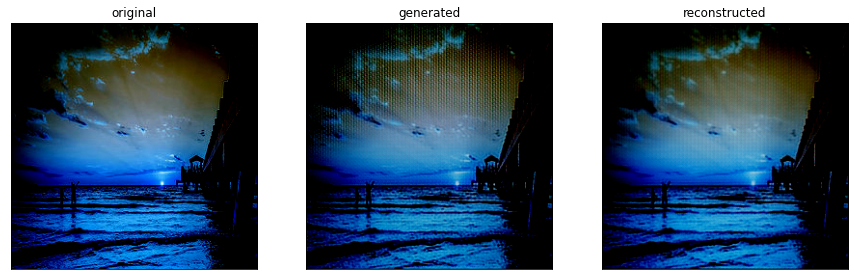

processed samples: 4000 in 501.2651300430298


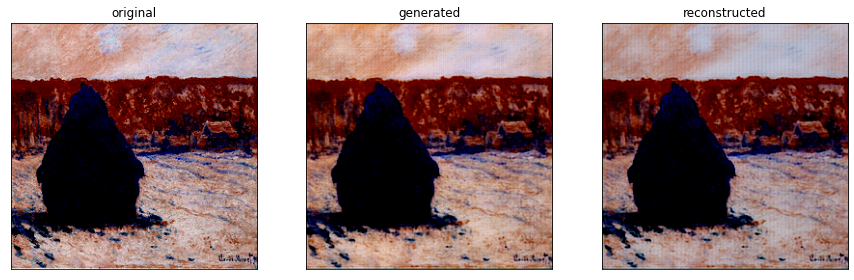

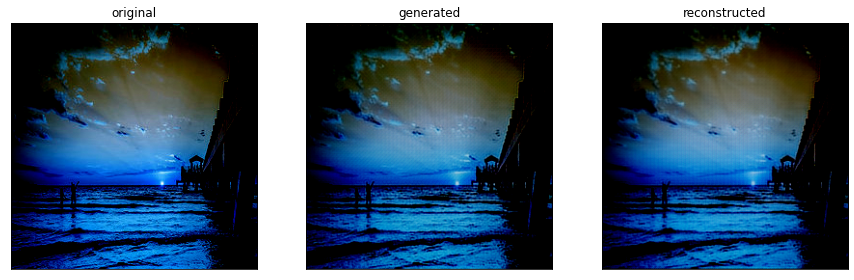

processed samples: 5000 in 503.2683470249176


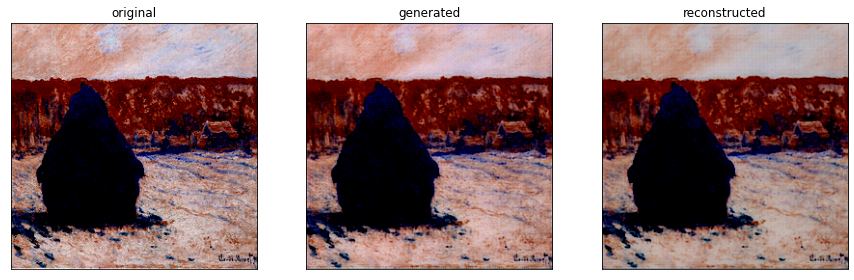

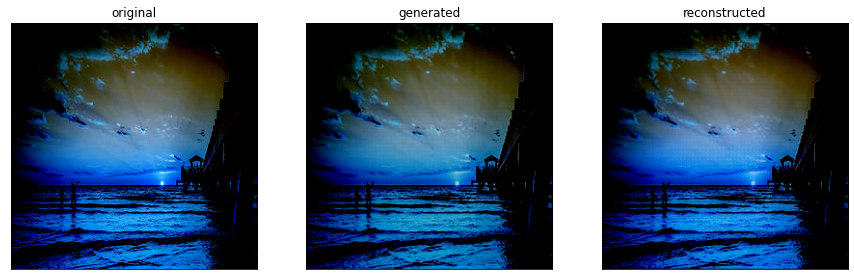

processed samples: 6000 in 523.6924793720245


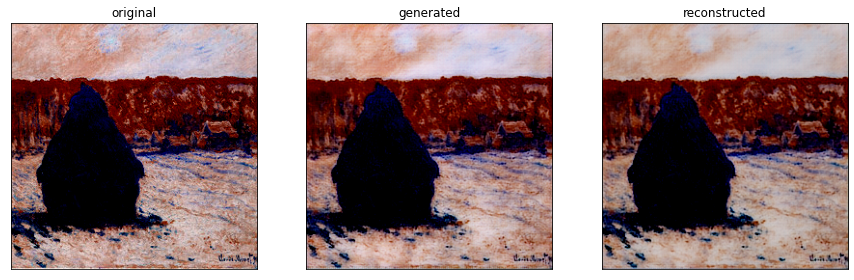

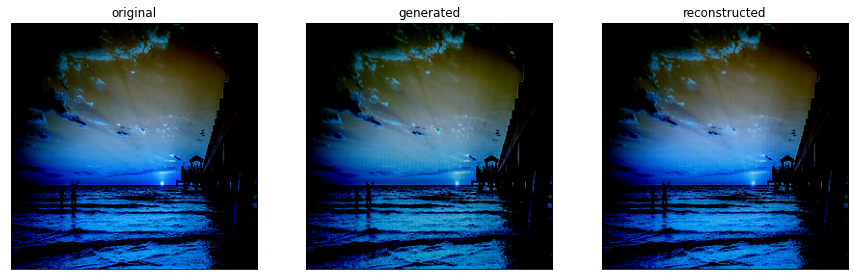

epoch 0:


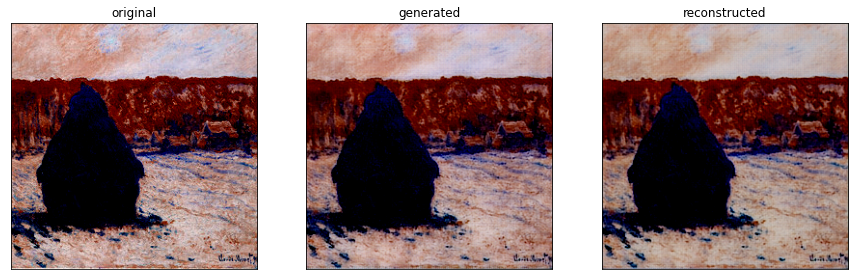

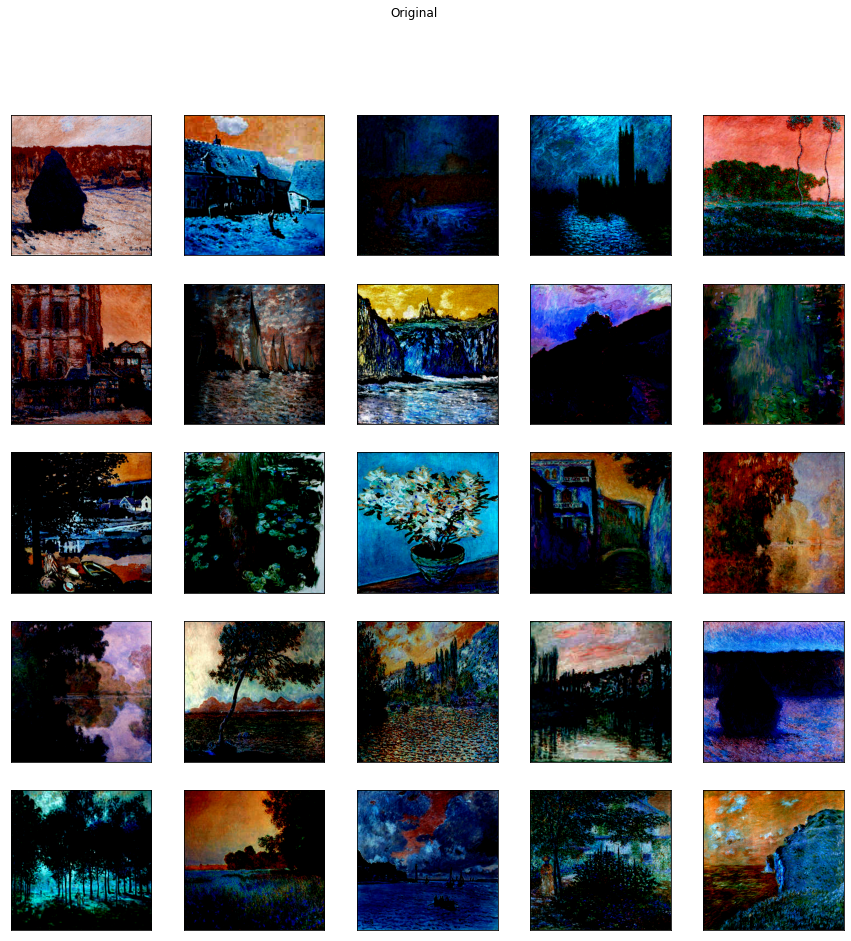

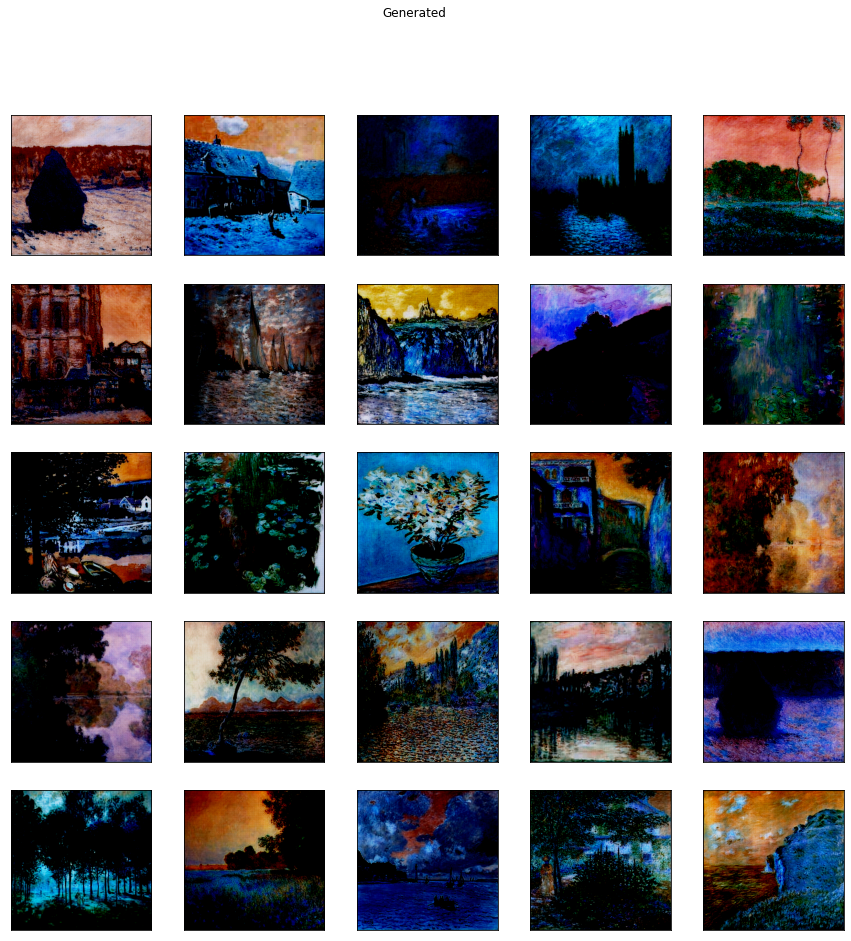

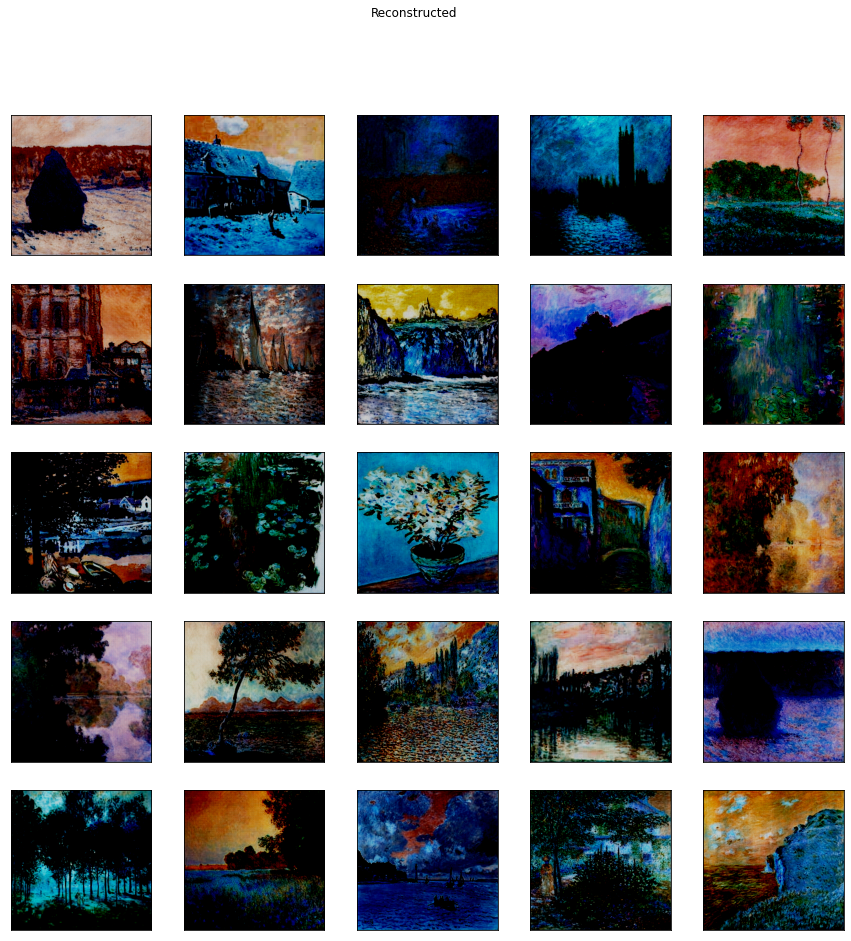

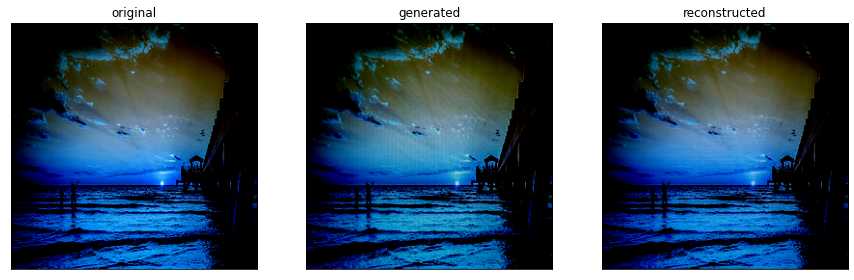

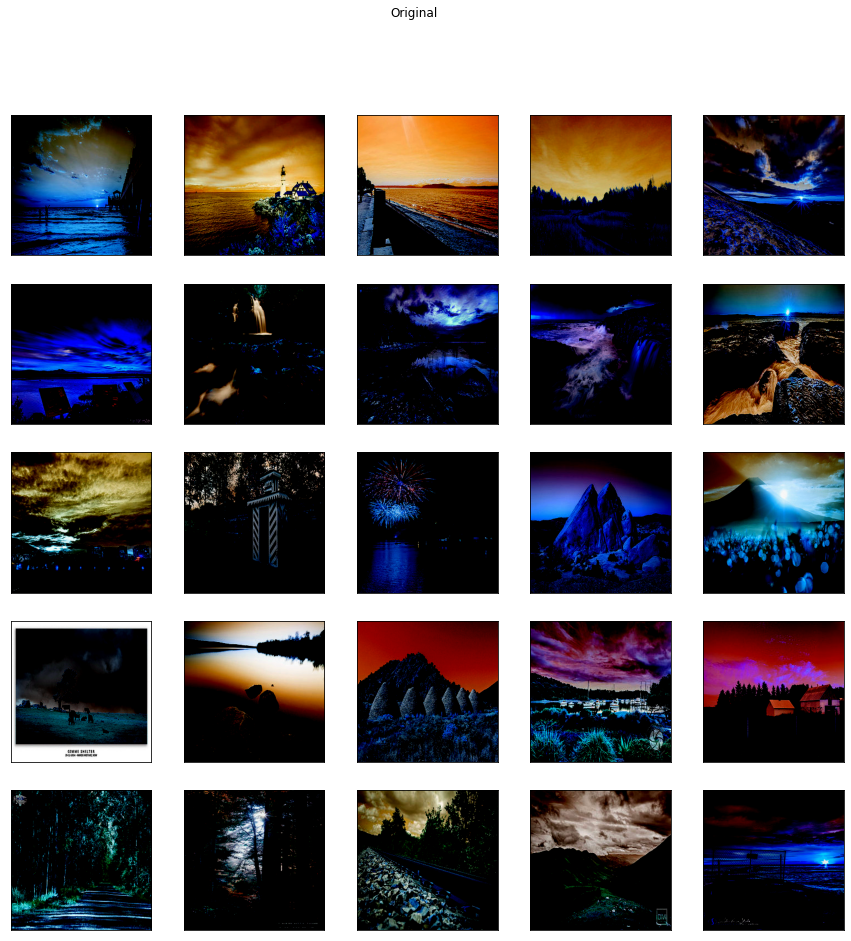

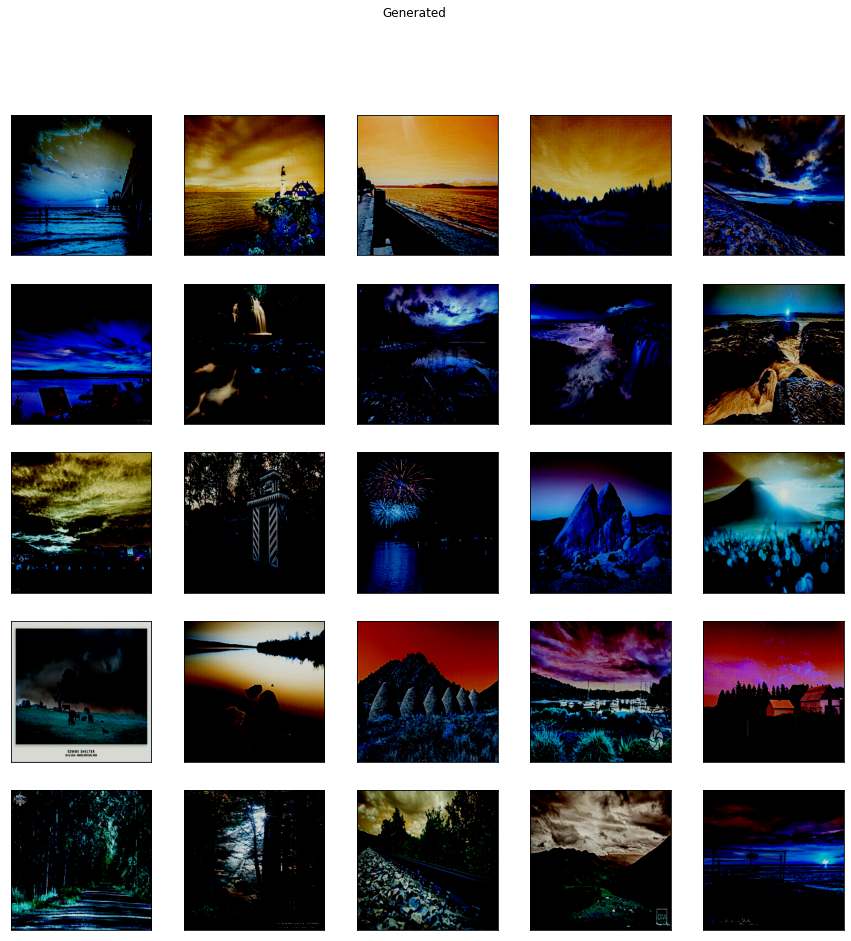

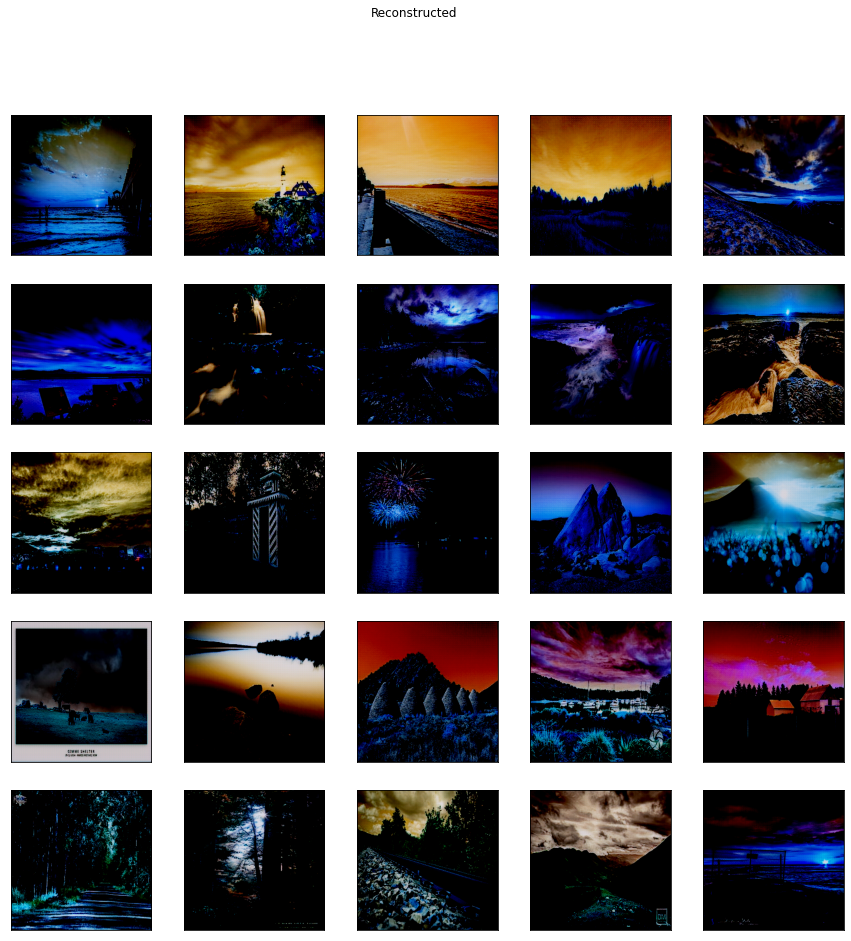

processed samples: 1000 in 516.7126636505127


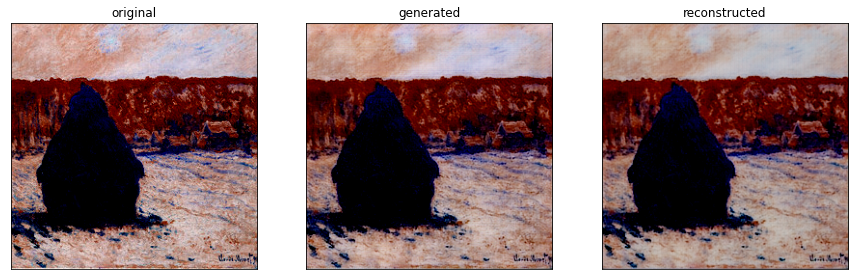

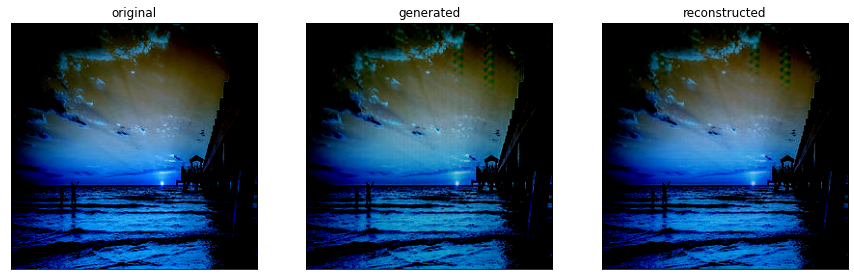

processed samples: 2000 in 493.28921604156494


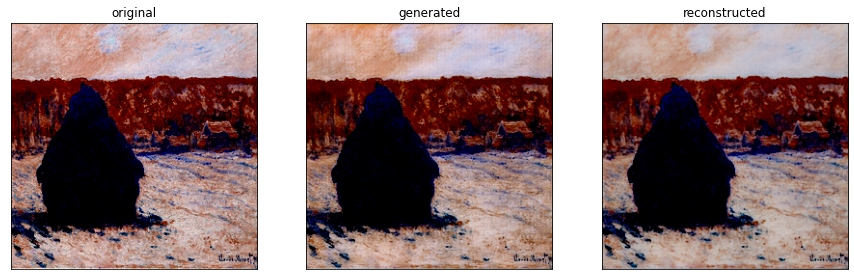

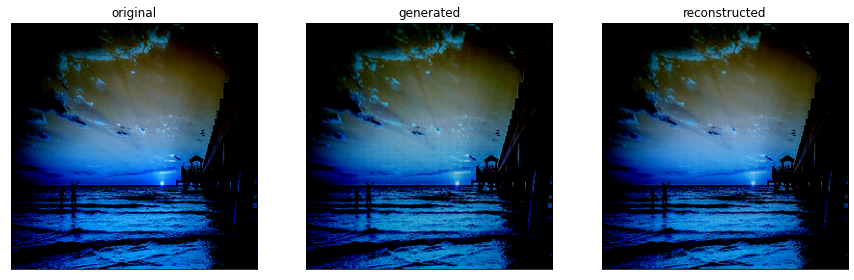

processed samples: 3000 in 490.05940771102905


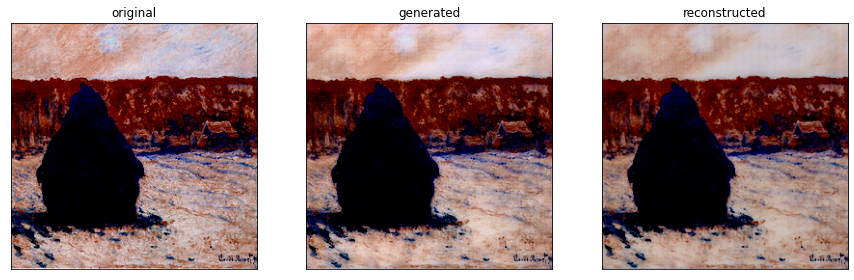

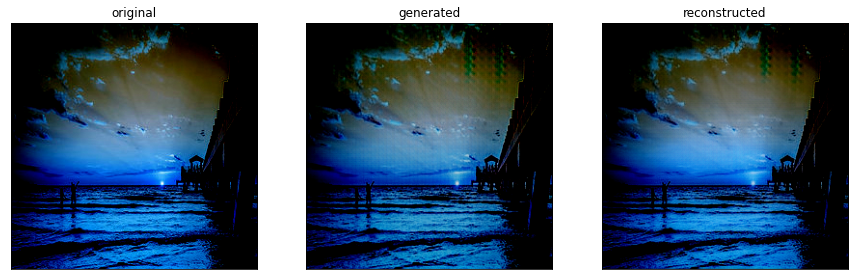

processed samples: 4000 in 513.2993879318237


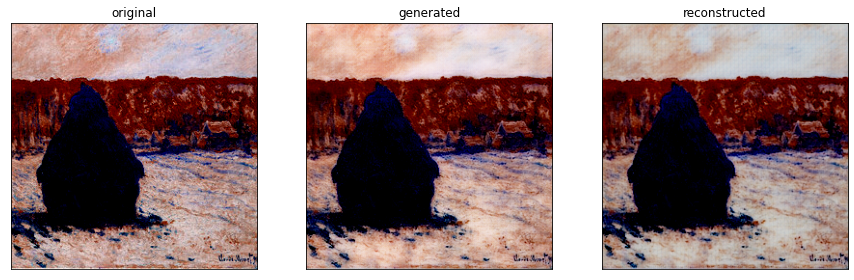

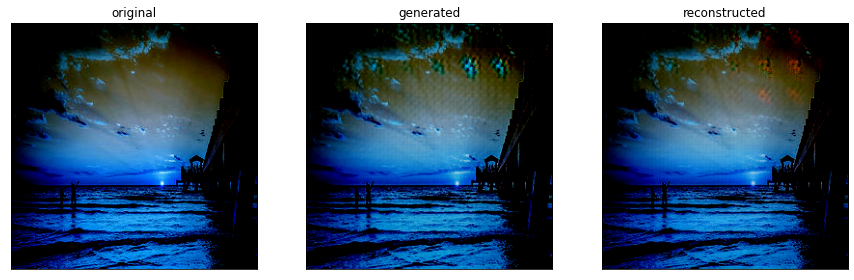

processed samples: 5000 in 500.90729808807373


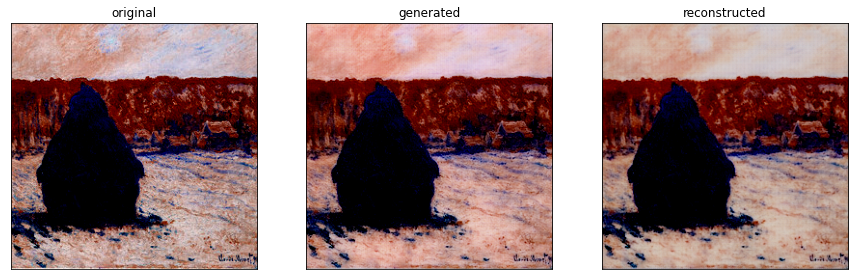

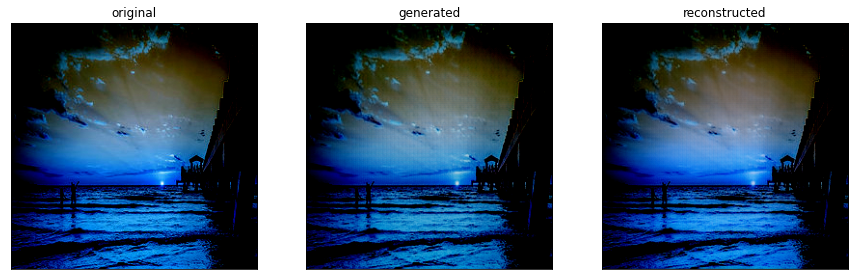

processed samples: 6000 in 493.4009966850281


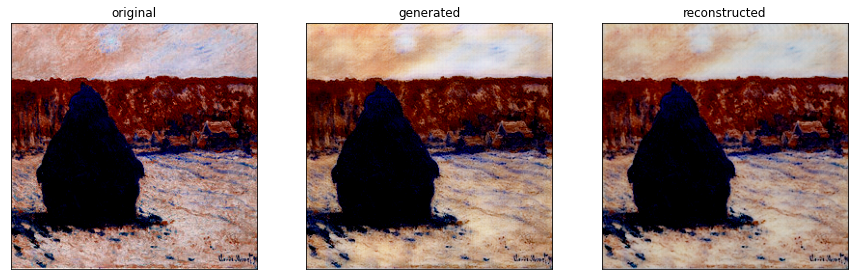

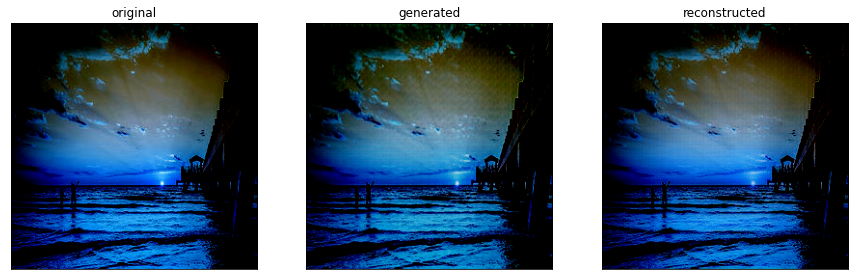

epoch 1:


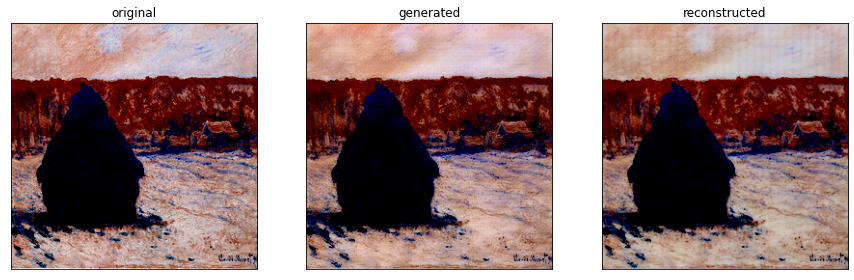

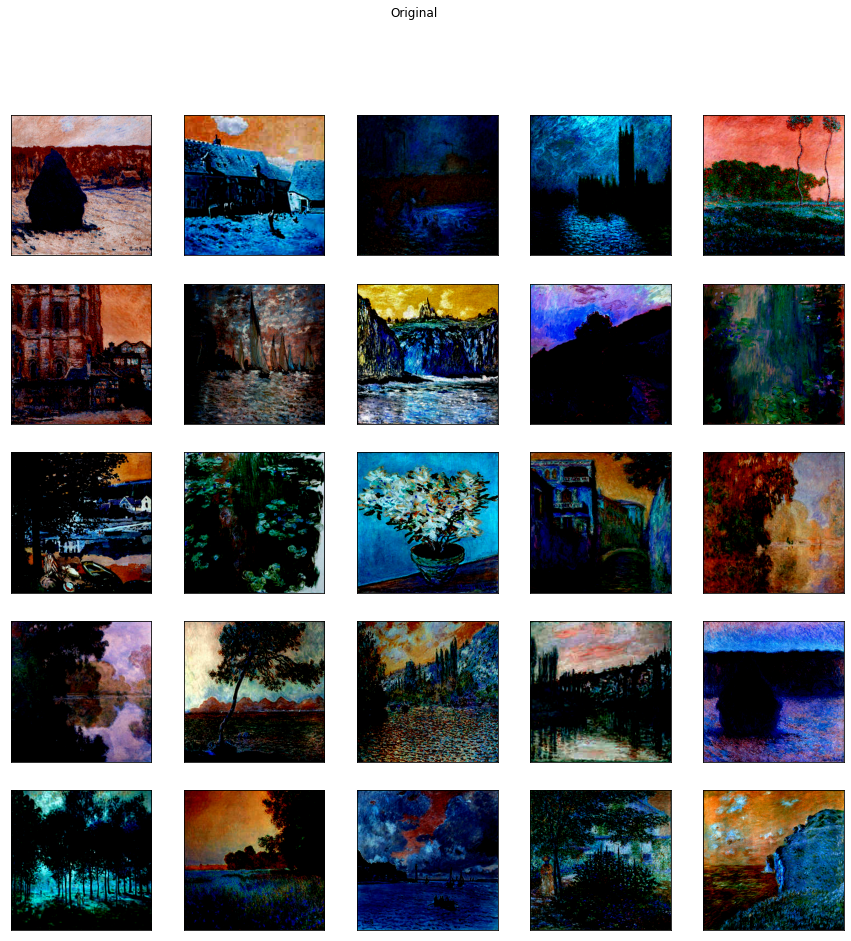

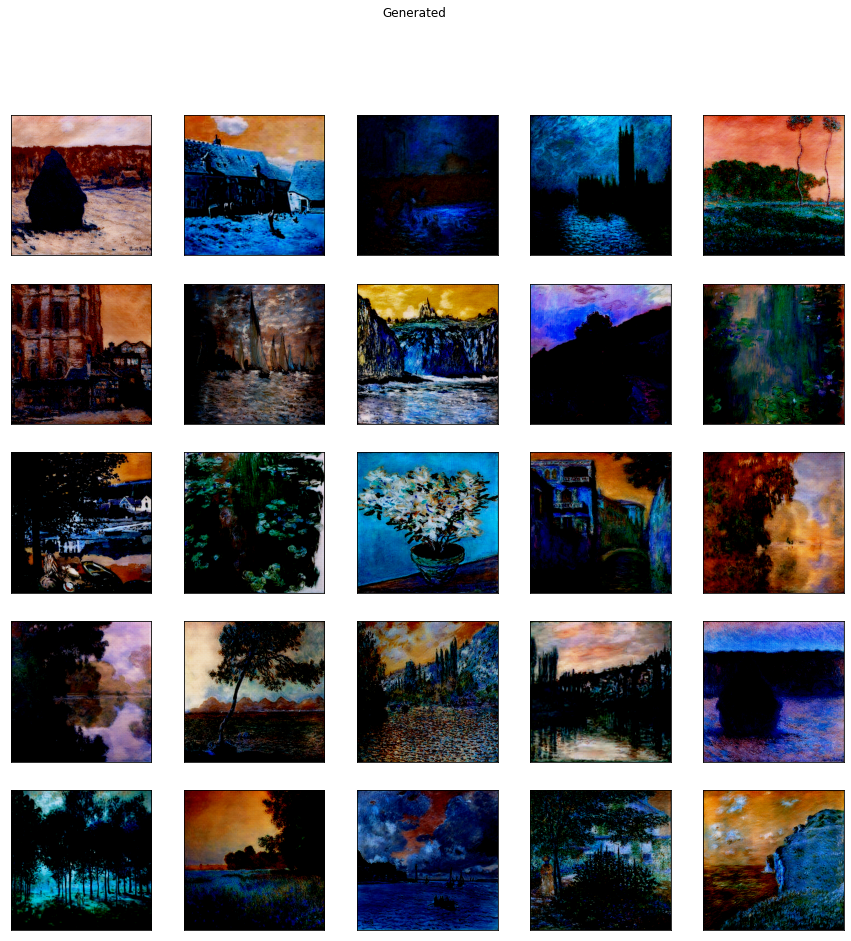

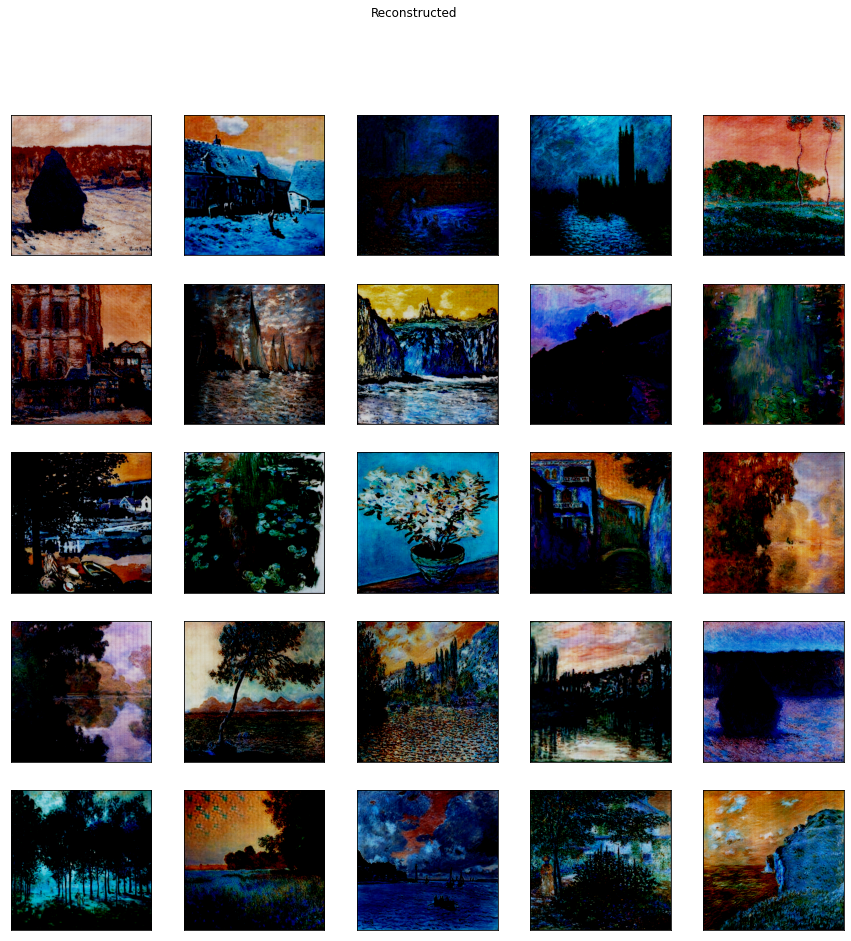

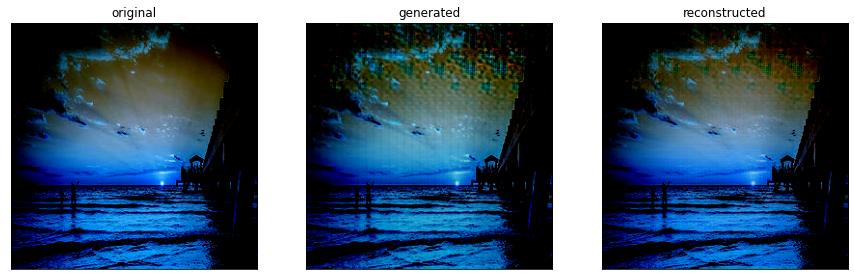

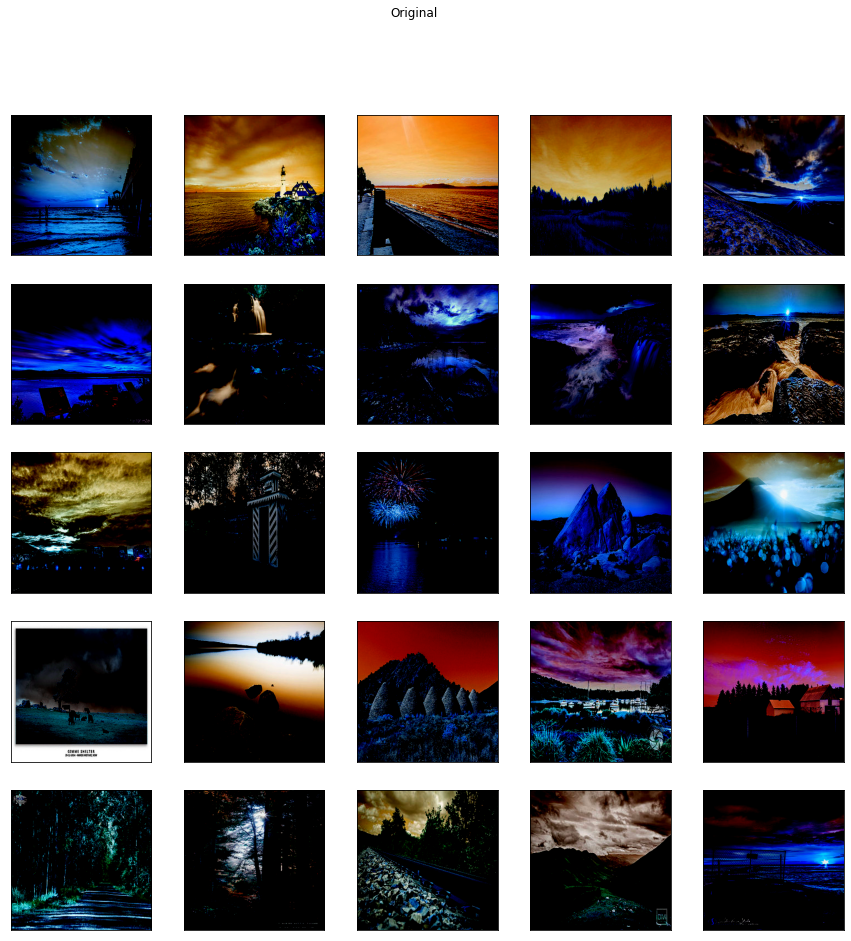

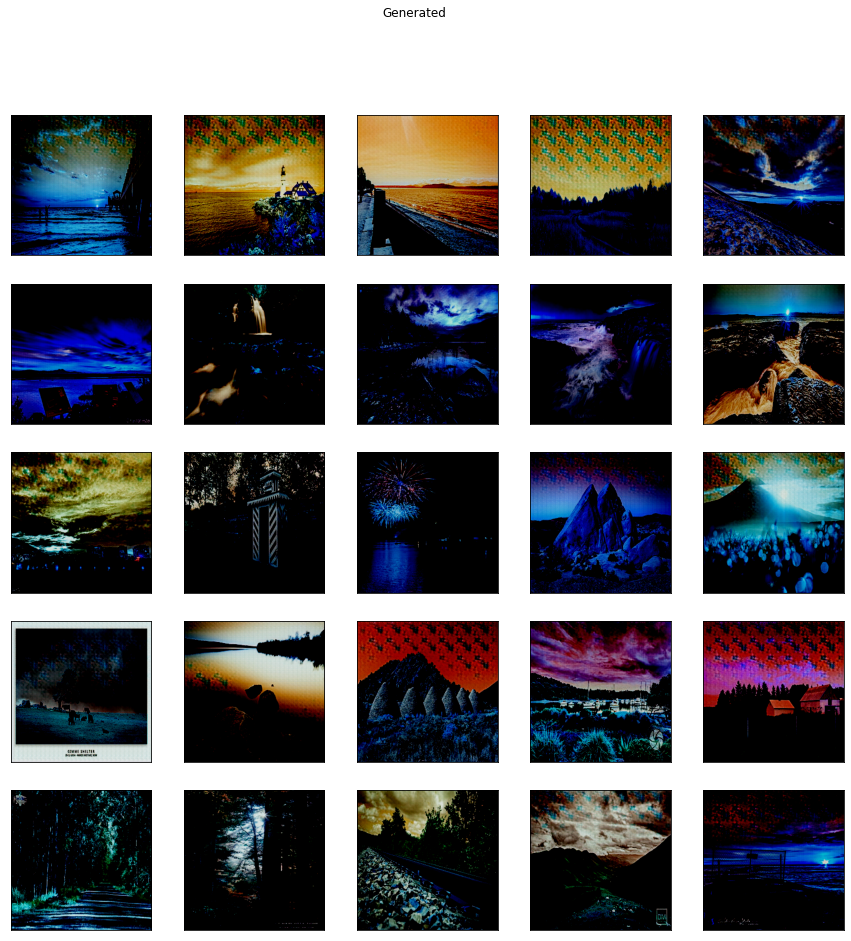

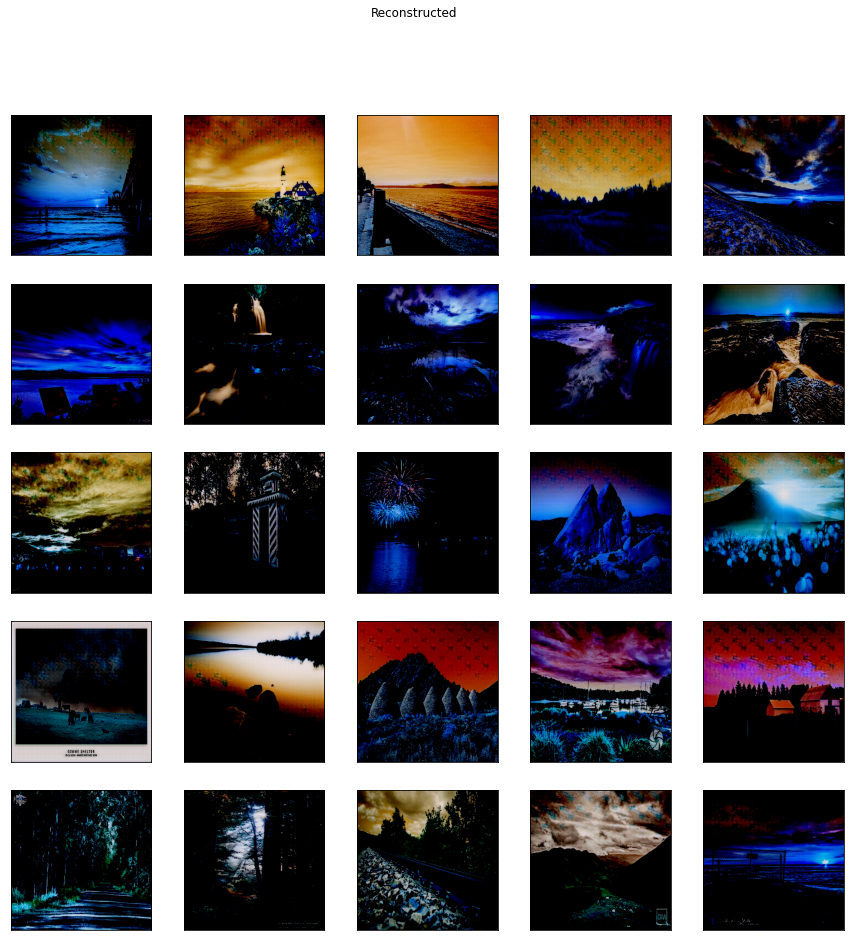

In [ ]:
losses = train(a_disc, b_disc, ab_gen, ba_gen, ab_total, ba_total, a_train, a_test[a_test_idx], b_test[b_test_idx])

## Plot losses
in the first cell we plot loss for each of 2 generators and the each of discriminators for the real and fake data. 
in the last cell we plot the overall loss function which is the some of adverserial, identity and cycle consistency loss. 

In [ ]:
ba_loss, a_disc_r, a_disc_f, ab_loss, b_disc_r, b_disc_f = losses

Text(0.5, 1.0, 'B Discriminator (fake data)')

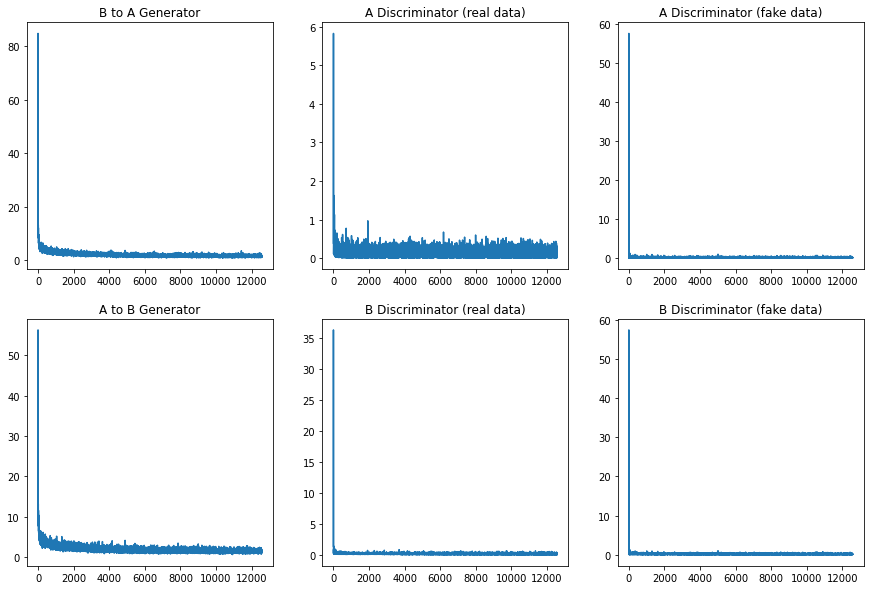

In [ ]:
fig, axs = plt.subplots(2, 3, figsize=(15, 10))
axs[0, 0].plot(ba_loss)
axs[0, 0].set_title('B to A Generator')
axs[0, 1].plot(a_disc_r)
axs[0, 1].set_title('A Discriminator (real data)')
axs[0, 2].plot(a_disc_f)
axs[0, 2].set_title('A Discriminator (fake data)')
axs[1, 0].plot(ab_loss)
axs[1, 0].set_title('A to B Generator')
axs[1, 1].plot(b_disc_r)
axs[1, 1].set_title('B Discriminator (real data)')
axs[1, 2].plot(a_disc_f)
axs[1, 2].set_title('B Discriminator (fake data)')

Text(0.5, 1.0, 'Total Loss')

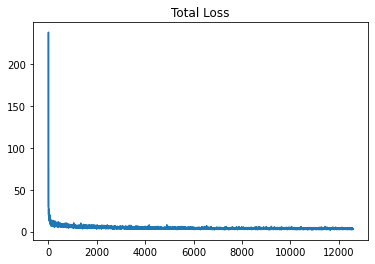

In [ ]:
total_loss = np.array(ba_loss) + np.array(a_disc_r) + np.array(a_disc_f) + np.array(ab_loss) + np.array(b_disc_r) + np.array(b_disc_f)
plt.plot(total_loss)
plt.title('Total Loss')